In [1]:
import json
import requests
import plotly.express as px
import difflib
import geopandas as gpd

import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns 
import numpy as np
import matplotlib.colors as mcolors

In [2]:
world_path = "https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/_work-in-progress/world.geojson" #name
italy_path ="https://raw.githubusercontent.com/openpolis/geojson-italy/master/geojson/limits_IT_regions.geojson" #reg_name
usa_path = "https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json" # default
eu_path = "https://raw.githubusercontent.com/leakyMirror/map-of-europe/master/GeoJSON/europe.geojson" #NAME

us_path = "https://raw.githubusercontent.com/PublicaMundi/MappingAPI/master/data/geojson/us-states.json"
path_africa = "https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/africa.geojson"
path_asia = 'https://gist.githubusercontent.com/hrbrmstr/94bdd47705d05a50f9cf/raw/0ccc6b926e1aa64448e239ac024f04e518d63954/asia.geojson'

#world = requests.get(world_path).json()

# Plotly

## Choroplet Italy

In [3]:
italy = requests.get(italy_path).json()

In [4]:
def check_names(df, var, geo, p_id='name'):
    names_geo = [geo['features'][i]['properties'][p_id] for i in range(len(geo['features']))]
    names_df = df[var].values.tolist()
    check = set(names_geo)
    for i in range(len(names_df)):
        if names_df[i] not in check:
            similarity=[]
            for names in check:
                output = difflib.SequenceMatcher(None, names, names_df[i]).ratio()
                if output > 0.6: 
                    similarity.append(names)
            print(f"--> '{names_df[i]}' idx: {i} --> similarity found --> {similarity}")

In [5]:
df = pd.read_excel("datasets/census.xlsx",)
df.drop(columns=["Unnamed: 23"], inplace=True)
df = df.transpose() # so to have the year as column to show!
df.columns = df.iloc[0]
df.reset_index(inplace=True)
df.columns = ['Regione']+ ['year_'+str(int(i)) for i in df.columns[1:]]
df = df.iloc[1:, ]

### the name must be the same!
check_names(df= df, var='Regione', geo =italy,  p_id='reg_name')
### df aspect
df.head(2)

--> 'Valle d'Aosta-Vallée d'Aoste' idx: 1 --> similarity found --> ["Valle d'Aosta/Vallée d'Aoste"]
--> 'Bolzano-Bozen' idx: 5 --> similarity found --> []
--> 'Trento' idx: 6 --> similarity found --> ['Veneto']


,Regione,year_1951,year_1961,year_1971,year_1981,year_1991,year_2001,year_2011
1,Piemonte,3518.0,3914.250,4432.0,4479.0,4303.0,4214.677,4363.916
2,Valle d'Aosta-Vallée d'Aoste,94.0,100.959,109.0,112.0,116.0,119.548,126.806


In [6]:
df.Regione.iloc[1] = "Valle d'Aosta/Vallée d'Aoste"

In [7]:
fig = px.choropleth(df, 
                    geojson=italy,
                    locations='Regione', 
                    color= 'year_1951', 
                    color_continuous_scale='viridis', 
                    featureidkey='properties.reg_name',
                    projection="mercator",
                    labels={'year_1951':'Census-1951'},
                    hover_name = 'Regione',
                    hover_data={'year_1961':True, 
                                'year_1971':True, 
                                'year_1981':False, 
                                'year_1991':True })

fig.update_layout(
    title_text='Census Italy on 1951',
    geo= dict(fitbounds="locations", 
              visible=False, 
              showlakes=True, 
              lakecolor="lightblue",
              resolution=50),
    annotations = [dict(
        x=0.55,
        y=0.02,
        xref='paper',
        yref='paper',
        text='Source: <a href="https://github.com/GabrieleGhisleni">GGabriele Ghisleni News</a>',
        showarrow = False)])

fig.show()

## Choroplet USA

In [8]:
usa = requests.get(usa_path).json()

In [9]:
geos = pd.read_csv("datasets/states_geo.tsv")
votes = pd.read_csv("datasets/states_vote.tsv")
df = pd.merge(geos, votes, on="state")
df.head(2)

,state,fips,pop,gdp,poverty,stateid,X,Y,EV,dem_votes,rep_votes,other_votes,dem_this_margin,margin_shift,called,final,Total 2016 Votes
0,Alabama,1,4903185,228142.6,801758,AL,6,1,9,849624,1441170,32488,-25.5,2.3,R,Yes,2123372
1,Alaska,2,731545,54385.6,80224,AK,0,6,3,153778,189951,15801,-10.1,4.7,R,Yes,318608


In [10]:
fig = px.choropleth(df, 
                    geojson=usa, 
                    locations='stateid', 
                    color='dem_votes',
                    color_continuous_scale="ice",
                    scope="usa",
                    labels={'dem_votes':'Democratic votes'},
                    hover_name = 'state',
                    locationmode='USA-states',
                    hover_data={'Total 2016 Votes':True, 
                                'called':True, 
                                'stateid':False})

fig.update_layout(
    title_text='USA DEM',
    geo= dict(visible=False,
              showlakes=True, lakecolor="lightblue",  
              resolution=50,
              showcountries=True),  

    annotations = [dict(
        x=0.55,
        y=0.0,
        xref='paper',
        yref='paper',
        text='Source: <a href="https://www.cia.gov/library/publications/the-world-factbook/fields/2195.html">\
            GGabriele.Ghisleni News</a>',
        showarrow = False)])

fig.show()

## Choroplet Europe

In [11]:
europe = requests.get(eu_path).json() #NAME

In [12]:
df = pd.read_csv("datasets/economist_data.csv")
df = df[(df.Region=="East EU Cemt Asia") | (df.Region == "EU W. Europe")]

check_names(df, 'Country', europe, 'NAME')
df.head(2)

--> 'Britain' idx: 7 --> similarity found --> []
--> 'Kazakhstan' idx: 23 --> similarity found --> []
--> 'Kyrgyzstan' idx: 24 --> similarity found --> []
--> 'Moldova' idx: 29 --> similarity found --> []
--> 'Tajikistan' idx: 43 --> similarity found --> []
--> 'Turkmenistan' idx: 45 --> similarity found --> ['Armenia']
--> 'Uzbekistan' idx: 47 --> similarity found --> []


,Country,HDI.Rank,HDI,CPI,Region
1,Albania,70,0.739,3.1,East EU Cemt Asia
5,Armenia,86,0.716,2.6,East EU Cemt Asia


In [13]:
df.Country.iloc[7] = "United Kingdom"

In [14]:
fig = px.choropleth(df, 
                    geojson=europe, 
                    locations='Country', 
                    color='HDI',
                    color_continuous_scale="fall",
                    scope="europe",
                    labels={'HDI':'Human Development Index'},
                    hover_name = 'Country',
                    hover_data={'CPI':True, 
                                'HDI.Rank':True, 
                                'Country':False, 
                                'Region':True },
                    featureidkey= 'properties.NAME')

fig.update_layout(
    title_text='Human Development Index',
    geo= dict(fitbounds="locations",
              visible=False,
              showlakes=True, lakecolor="lightblue",  
              resolution=50,
              showcountries=True),  
    annotations = [dict(
        x=0.55,
        y=-0.1,
        xref='paper',
        yref='paper',
        text='Source: <a href="https://github.com/GabrieleGhisleni">GGabriele Ghisleni News</a>',
        showarrow = False)])

fig.show()

# GeoPandas

In [15]:
natural_world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres")) # States

# continent = ['Africa', 'Antarctica', 'Asia', 'Europe', 'North America',
#             'Oceania', 'Seven seas (open ocean)', 'South America']

europe = natural_world[(natural_world.continent == 'Europe') | (natural_world.name == 'Turkey')]

In [16]:
df = pd.read_csv("datasets/population_by_country_2020.csv")
df.rename(columns={'Country (or dependency)':'name'}, inplace=True)

def cc(x):
    if x > 100000000: return "100000000 +"
    elif x < 100000000 and x > 80000000: return "80000000-100000000"
    elif x < 80000000 and x > 60000000: return "60000000-100000000"
    elif x < 60000000 and x > 40000000: return "40000000-100000000"
    elif x < 40000000 and x > 30000000: return "30000000-100000000"
    elif x < 30000000 and x > 20000000: return "20000000-100000000"
    elif x < 20000000 and x > 150000000: return "15000000-100000000"
    elif x < 15000000 and x > 100000000: return "10000000-100000000"
    elif x < 10000000 and x > 5000000: return "5000000-100000000"
    elif x < 5000000 and x > 2000000: return "2000000-100000000"
    elif x < 2000000 and x > 1000000: return "1000000-100000000"
    else: return "-1000000"
    
df.name.iloc[154] = 'Macedonia'
df.name.iloc[53] = 'Czechia'
df.name.iloc[25] = 'Bosnia and Herz.'

df['color'] = df['Population (2020)'].apply(cc)
final = pd.merge(europe, df, on='name')
df.sort_values('color', inplace=True)

final = europe.merge(df[['Population (2020)', 'name','color']], on='name')

c:\users\dell\venv\jupyter\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



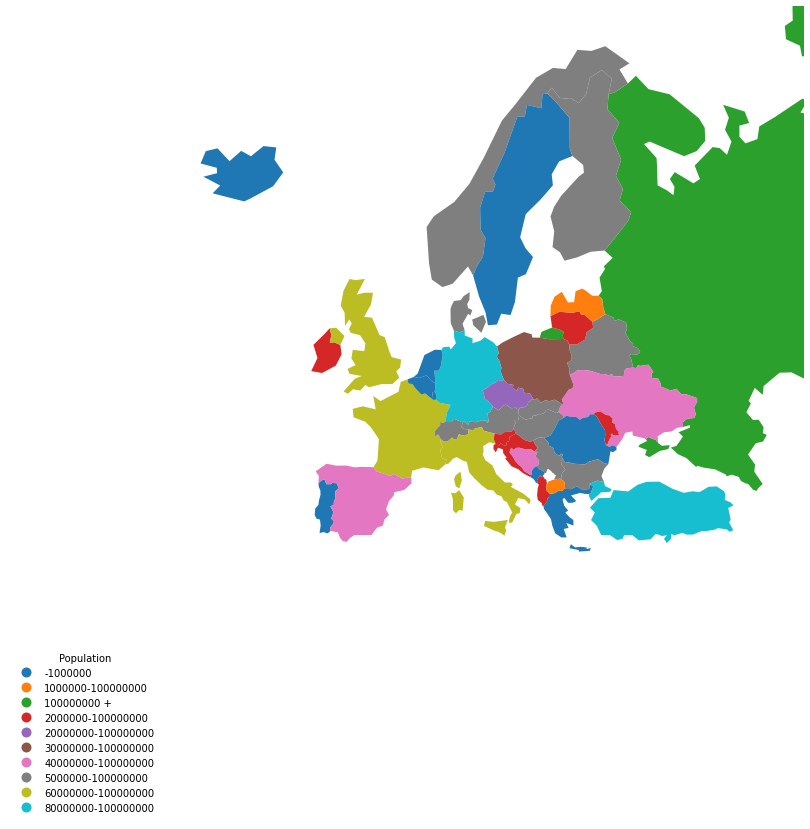

In [17]:
final = final.to_crs("EPSG:3395") # mercador

# Scheme available: ['boxplot', 'equalinterval', 'fisherjenks', 'fisherjenkssampled', 'headtailbreaks', 'jenkscaspall', 'jenkscaspallforced', 
#  'jenkscaspallsampled', 'maxp', 'maximumbreaks', 'naturalbreaks', 'quantiles', 'percentiles', 'stdmean', 'userdefined']

fig,axes = plt.subplots(figsize=(15,15))

final.plot(ax=axes,
           column='color',
           linewidth = 0.1,
           scheme=None,
           cmap = "tab10",
           aspect= 'auto',
           
           legend=True,
           legend_kwds=dict(loc='lower left', frameon=False, title='Population'))

minx, miny, maxx, maxy = final.total_bounds
axes.set_xlim(-5500000, 6000000)
axes.set_ylim( miny, 12000000)
axes.axis('off')
plt.show()

## GeoPandas Cities

In [18]:
# European capitals
gdf_mask = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
gdf = gpd.read_file(gpd.datasets.get_path("naturalearth_cities"),mask=gdf_mask[gdf_mask.continent=="Europe"])

df = pd.read_csv("datasets/cities_pop_timeline.csv")
df.drop(columns=['Unnamed: 1'], inplace=True)
df = df[df["2001"] != '..']
df_italy = df.loc[df.Year.str.strip().str.startswith("IT")].copy()
df_italy['fuacode_si'] = df_italy.Year.apply(lambda x: x.split(":")[0].strip())
df_italy['city'] = df_italy.Year.apply(lambda x: x.split(":")[1].strip())
df_italy.drop(columns=['Year'], inplace=True)
df_italy= df_italy[['fuacode_si', 'city', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008',
          '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017','2018']]
df_italy.head(2)

,fuacode_si,city,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
302,IT001,Rome,3784074,3784061,3795242,3820857,3859309,3880991,3906489,3954606,3998011,4030976,4064437,4080343,4125697,4403527,4423757,4421905,4434179,4429025
303,IT002,Milan,4486580,4490419,4494312,4513809,4571009,4593156,4606058,4625817,4644549,4670856,4705564,4728869,4785247,4908015,4931848,4944254,4956499,5145657


In [19]:
for c in df_italy.columns[2:]:
    try:  df_italy.loc[:,c]=df_italy.loc[:,c].astype('float')
    except: 
        df_italy.loc[:,c]= df_italy.loc[:,c].str.replace(",",".")
        df_italy.loc[:,c]=df_italy.loc[:,c].astype('float')
res=[]
for ic in range(len(df_italy)):
    names = df_italy.iloc[ic, :2].values.tolist()
    mean = df_italy.iloc[ic, 2:].mean()
    names.extend([round(mean,2)])
    res.append(names)

df_italy = pd.DataFrame(res, columns=['fip', 'city','mean_over_years'])
pd.options.display.float_format = '{:.4f}'.format
df_italy.head(2)

,fip,city,mean_over_years
0,IT001,Rome,4066527.0000
1,IT002,Milan,4711251.0000


In [20]:
from shapely.geometry import Point
with open('datasets/it.json') as f:
    it_ = json.load(f)

res=[]
for city in it_: res.append([city['city'], Point(float(city['lng']), float(city['lat']))])
df = pd.DataFrame(res, columns=['city', 'geometry'])
italy_geo=gpd.GeoDataFrame(df)
italy_geo.head(2)

,city,geometry
0,Rome,POINT (12.48280 41.89310)
1,Milan,POINT (9.19000 45.46690)


In [21]:
final = pd.merge(italy_geo, df_italy, on='city')
final.head(1)

,city,geometry,fip,mean_over_years
0,Rome,POINT (12.48280 41.89310),IT001,4066527.0000


In [22]:
regions = gpd.read_file(italy_path)
regions.head()

,reg_name,reg_istat_code_num,reg_istat_code,geometry
0,Piemonte,1,01,"POLYGON ((7.13605 45.27996, 7.13601 45.28040, ..."
1,Valle d'Aosta/Vallée d'Aoste,2,02,"POLYGON ((7.73455 45.92365, 7.73590 45.92744, ..."
2,Lombardia,3,03,"MULTIPOLYGON (((8.57964 45.75172, 8.57532 45.7..."
3,Trentino-Alto Adige/Südtirol,4,04,"POLYGON ((12.01396 46.55091, 12.01376 46.55077..."
4,Veneto,5,05,"POLYGON ((10.63538 45.53543, 10.63228 45.56846..."


In [23]:
def show_values_on_bars(axs, h_v="v", space_x=0.12,space_y=0.1, round_=2,fontdict=None, rotation = 0):
    def _show_on_single_plot(ax):
        if h_v == "v":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() / 2 + space_x
                _y = p.get_y() + p.get_height() + (space_y)
                if not np.isnan(p.get_width()):
                    value = round(p.get_height(),2)
                    if value > 100000000: value = f"{round(value/100000000,round_)}kkk"
                    elif value > 100000: value=   f"{round(value/100000,round_)}kk"
                    elif value > 1000: value=f"{round(value/1000,round_)}k"
                    if fontdict: ax.text(_x, _y, value, ha="left", fontdict=fontdict,rotation=rotation)
                    else: ax.text(_x, _y, value, ha="left",rotation=rotation)
        elif h_v == "h":
            for p in ax.patches:
                try:
                    _x = p.get_x() + p.get_width() + space_x
                    _y = p.get_y() + p.get_height() + space_y
                    if not np.isnan(p.get_width()):
                        value = round(p.get_width(),2)
                        if value > 100000000: value = f"{round(value/100000000,round_)}kkk"
                        elif value > 100000: value=   f"{round(value/100000,round_)}kk"
                        elif value > 1000: value=f"{round(value/1000,round_)}k"
                        if value < 0: _x-=0.27
                        if fontdict: ax.text(_x, _y, value, ha="left", fontdict=fontdict,rotation=rotation)
                        else: ax.text(_x, _y, value, ha="left",rotation=rotation)
                except: print(f'Error while preparing {str(p)}')
    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _show_on_single_plot(ax)
    else:
        _show_on_single_plot(axs)

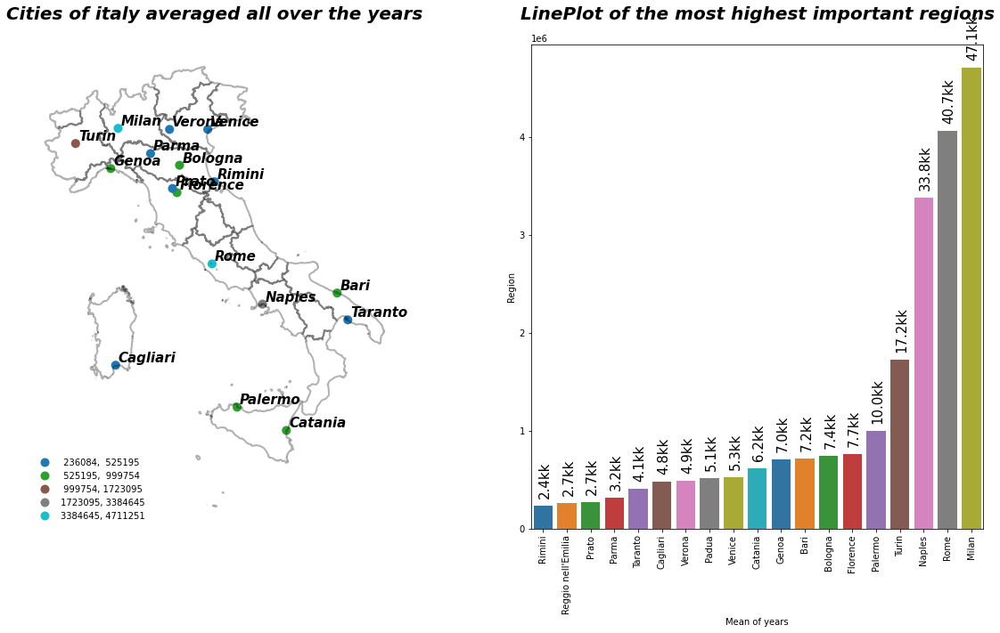

In [24]:

fig, ax= plt.subplots(1,2,figsize=(20,10))

axis_1 = ax[0]

final.plot(ax=axis_1,
           column='mean_over_years',
           linewidth = 0.1,
           scheme="NaturalBreaks", k=5,
           cmap = "tab10",
           aspect= 'auto',
           legend=True,      
           markersize=100,
          legend_kwds = dict(fmt = '{:.0f}', frameon=False, loc='lower left'))

regions.boundary.plot(ax=axis_1, color='black', alpha=0.3, linewidth=2)

for x, y, label in zip(final.geometry.x, final.geometry.y, final.city):
    axis_1.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points", 
                  size=15, weight='bold', style='italic')


axis_1.axis('off')

style_title= dict(size=20, weight='bold', style='italic')
style_labels = dict(size=15, style='italic')

title = "Cities of italy averaged all over the years"
axis_1.set_title(title +"\n",   fontdict=style_title)

###########

axes_2 =ax[1]
df_italy.sort_values('mean_over_years',inplace=True)


sns.barplot(ax=axes_2,data=df_italy, x='city', y='mean_over_years',
           palette='tab10')

dict_text = dict(size=15)
show_values_on_bars(axs = axes_2,round_=1, rotation=90, 
                    fontdict=dict_text,space_x=-0.2, space_y=100*1000)

title = "LinePlot of the most highest important regions"
ylabel = "Region"
xlabel= "Mean of years"

axes_2.set_title(title +"\n",   fontdict=style_title)
axes_2.set_ylabel(ylabel)
axes_2.set_xlabel(xlabel)
for tick in axes_2.get_xticklabels():
    tick.set_rotation(90)
    



## GeoPandas From GeoJson

In [25]:
italy = gpd.read_file(italy_path) # usual path

df = pd.read_excel("datasets/census.xlsx",)
df.drop(columns=["Unnamed: 23"], inplace=True)
df = df.transpose() # so to have the year as column to show!
df.columns = df.iloc[0]
df.reset_index(inplace=True)
df.columns = ['Regione']+ ['year_'+str(int(i)) for i in df.columns[1:]]
df = df.iloc[1:, ]
italy.rename(columns={"reg_name":"Regione"},inplace=True)

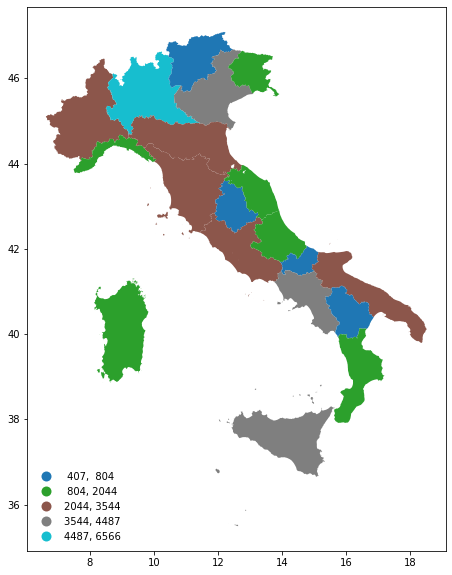

In [26]:
merged = pd.merge(italy, df, on='Regione')
fig, axes= plt.subplots(figsize=(10,10))
merged.plot(ax=axes,
           column='year_1951',
           linewidth = 0.1,
           scheme="NaturalBreaks", k=5,
           cmap = "tab10",
           aspect= 'auto',
           legend=True,      
           markersize=100,
           legend_kwds = dict(fmt = '{:.0f}', frameon=False, loc='lower left'))
plt.show()